In [1]:
import cv2
import numpy as np
import glob
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
%matplotlib inline

In [35]:
plt.rcParams["figure.figsize"] = (15,8)

In [2]:
folder_path = "./data/calibration_wide/" + "*.jpg"

In [3]:
CHECKERBOARD = (6, 8)

In [4]:
subpix_criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-3)
calibration_flags = cv2.fisheye.CALIB_RECOMPUTE_EXTRINSIC + cv2.fisheye.CALIB_FIX_SKEW + cv2.fisheye.CALIB_CHECK_COND


In [5]:
objp = np.zeros((1, CHECKERBOARD[0] * CHECKERBOARD[1], 3), np.float32)

In [6]:
objp[0, :, :2] = np.mgrid[0: CHECKERBOARD[0], 0:CHECKERBOARD[1]].T.reshape(-1, 2)
print(objp.shape)

(1, 48, 3)


In [7]:
_img_shape = None
#3d point in real world
objpoints = []
# 3d points in image plane
imgpoints = []

In [8]:
images = glob.glob(folder_path)
print("[INFO] Number of images in the folder : ", len(images))

[INFO] Number of images in the folder :  36


In [9]:
num_ret_true = 0
for img in tqdm(images):
    
    img = cv2.imread(img)
    
    if _img_shape == None:
        _img_shape = img.shape[:2]
    else:
        # all images must share the same size
        assert _img_shape == img.shape[:2]  
    
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # find the corners on the checkerboard
    ret, corners = cv2.findChessboardCorners(gray_img,
                                             CHECKERBOARD, 
                                             None)
    
    if ret == True:
        
        num_ret_true += 1
        objpoints.append(objp)
        corners = cv2.cornerSubPix(gray_img, 
                                   corners, 
                                   (10, 10), 
                                   (-1, -1), 
                                   subpix_criteria)
        imgpoints.append(corners)

print("Number of ret True: ", num_ret_true)

        
    

100%|█████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:06<00:00,  5.37it/s]


Number of ret True:  35


In [10]:
N_OK = len(objpoints)
K = np.zeros((3, 3))
D = np.zeros((4, 1))

rvecs = [np.zeros((1, 1, 3), dtype=np.float32) for i in range(N_OK)]
tvecs = [np.zeros((1, 1, 3), dtype=np.float32) for i in range(N_OK)]

In [11]:
rms, camera_matrix, dist_coefs, rvecs, tvecs = \
    cv2.fisheye.calibrate(
        objpoints,
        imgpoints,
        gray_img.shape[::-1],
        K,
        D,
        rvecs,
        tvecs,
        calibration_flags,
        (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER, 30, 1e-6),
    )

In [12]:
DIM = _img_shape[::-1]
K = np.array(K.tolist())
D = np.array(D.tolist())

In [51]:
# undistort
def undistort(img_path, balance = 0.0):
    
    img = cv2.imread(img_path)
    # dimension of input to undistorrt
    dimesion = img.shape[:2][::-1]
    # "Image to undistort needs to have same aspect ratio as the ones used in calibration"
    assert dimesion[0]/dimesion[1] == DIM[0]/DIM[1] 
    
    # scale by the image dimension
    scaled_K = K * dimesion[0] / DIM[0]
    # value in the most right lower of matrix calibration
    scaled_K[2][2] = 1.0
    
    new_K = cv2.fisheye.estimateNewCameraMatrixForUndistortRectify(scaled_K, 
                                                                   D, 
                                                                   dimesion, 
                                                                   np.eye(3), 
                                                                   balance=balance)
    
    map1, map2 = cv2.fisheye.initUndistortRectifyMap(scaled_K, D, np.eye(3), new_K, dimesion, cv2.CV_32FC1)
        
    ### Save the result
    filename = "/cameraMatrix.txt"
    np.savetxt(filename, scaled_K, delimiter=',')
    filename = "/cameraDistortion.txt"
    np.savetxt(filename, D, delimiter=',')
    ###
    
#     undistorted_img = cv2.remap(img, 
#                                 map1, 
#                                 map2, 
#                                 interpolation = cv2.INTER_LINEAR, 
#                                 borderMode=cv2.BORDER_TRANSPARENT)

    print(img_path)
    name = "undistorted_" + str(balance) + "_" + os.path.basename(img_path)
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistorted = cv2.remap(img, 
                            map1, 
                            map2, 
                            interpolation = cv2.INTER_LINEAR, 
                            borderMode = cv2.BORDER_CONSTANT)        

#     fig = plt.figure()
    
#     ax1 = fig.add_subplot(1,2,1)
#     ax1.set_title("Original")    
#     ax1.plot(img)
    
#     ax2 = fig.add_subplot(1,2,2)    
#     ax2.set_title("Undistorted")
#     ax2.plot(undistorted)
#     # Save the full figure...
#     fig.savefig(name)
#     #plt.imshow(fig)
#     plt.show()
    
    name = "undistorted_" + str(balance) + "_" + os.path.basename(img_path)
    
    ax = plt.subplot(121)
    ax.set_title("Original")
    plt.imshow(img)

    ax = plt.subplot(122)
    ax.set_title("Undistorted")
    plt.imshow(undistorted)
    plt.savefig(name)
    plt.show()
    

./data/calibration_wide\GOPR0032.jpg


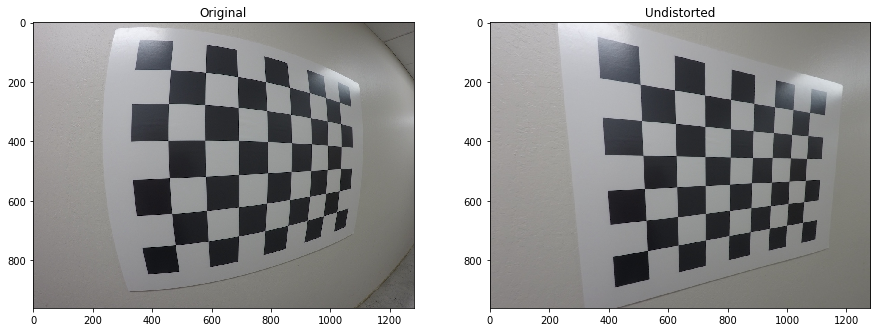

./data/calibration_wide\GOPR0033.jpg


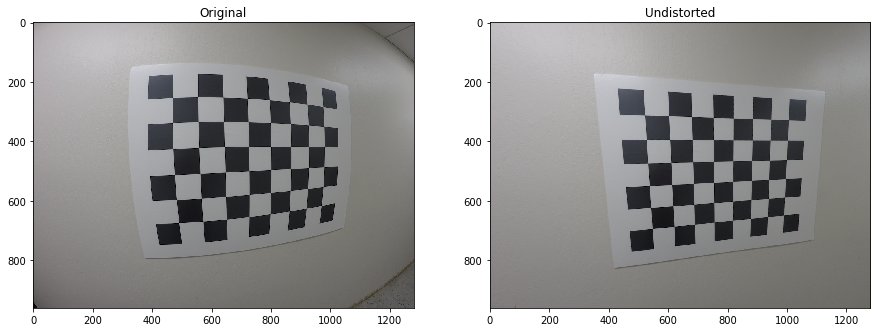

./data/calibration_wide\GOPR0034.jpg


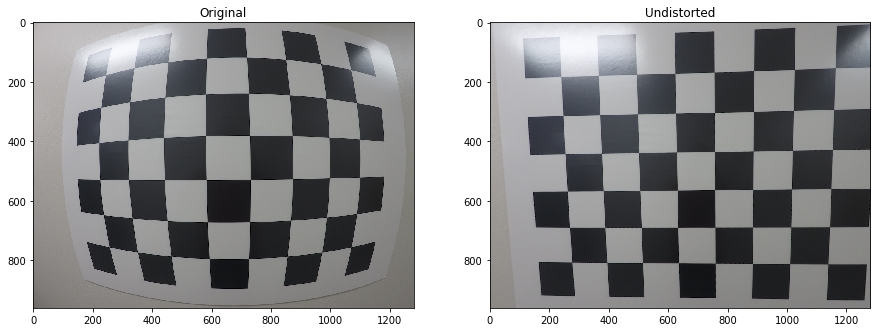

./data/calibration_wide\GOPR0035.jpg


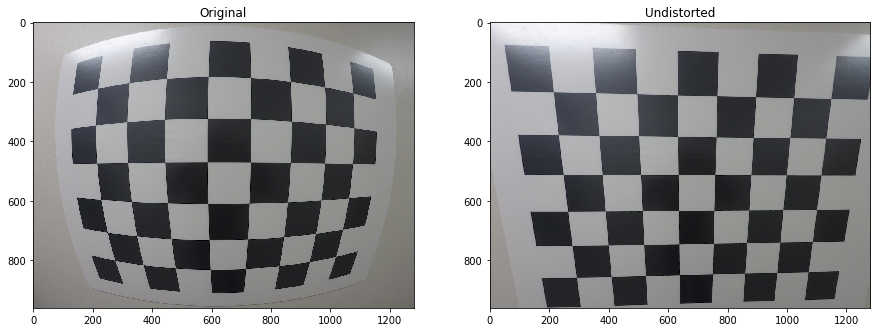

./data/calibration_wide\GOPR0036.jpg


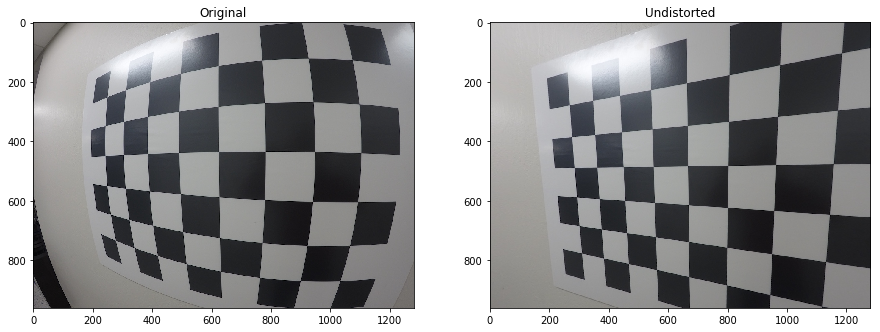

./data/calibration_wide\GOPR0037.jpg


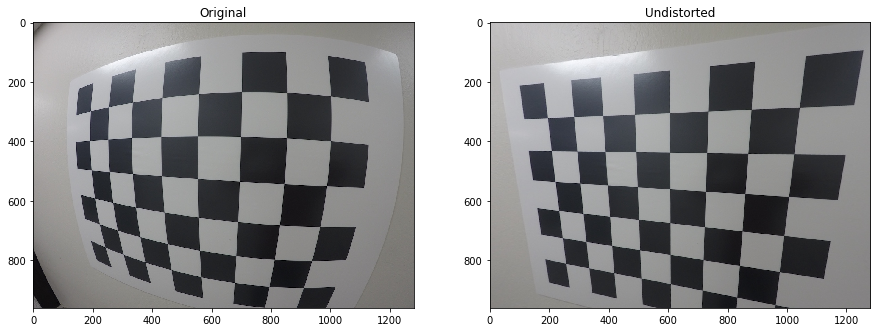

./data/calibration_wide\GOPR0038.jpg


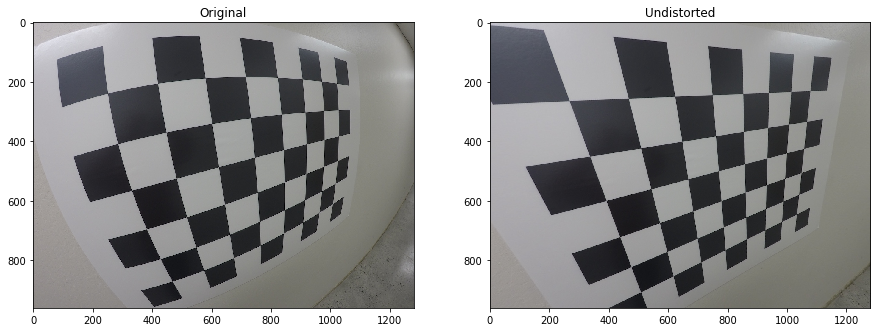

./data/calibration_wide\GOPR0040.jpg


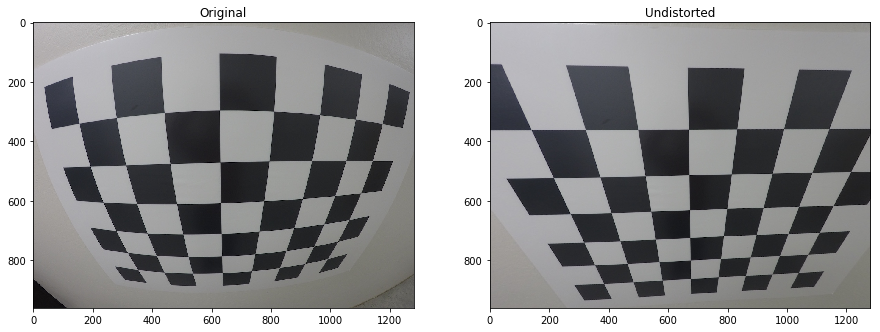

./data/calibration_wide\GOPR0041.jpg


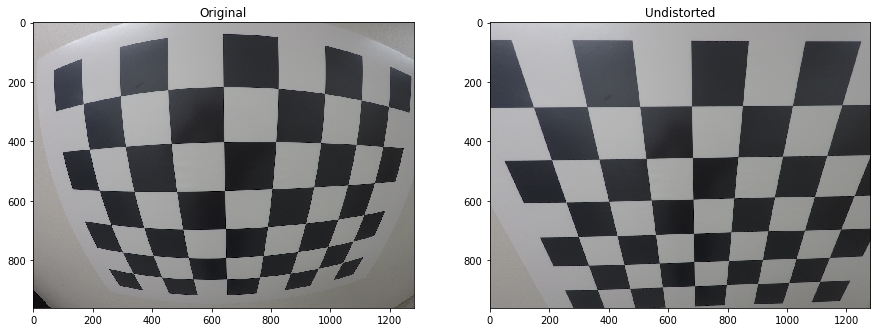

./data/calibration_wide\GOPR0042.jpg


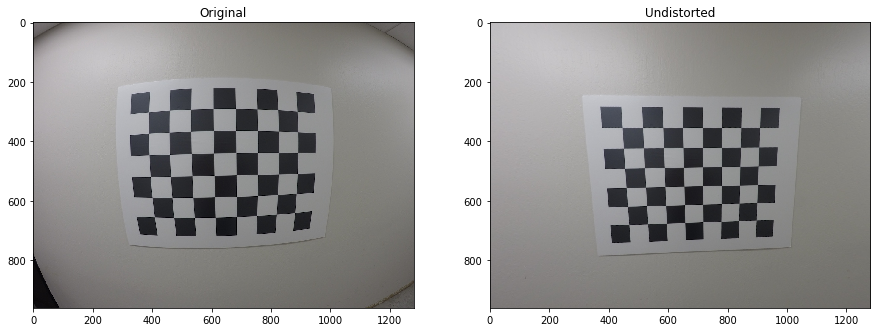

./data/calibration_wide\GOPR0043.jpg


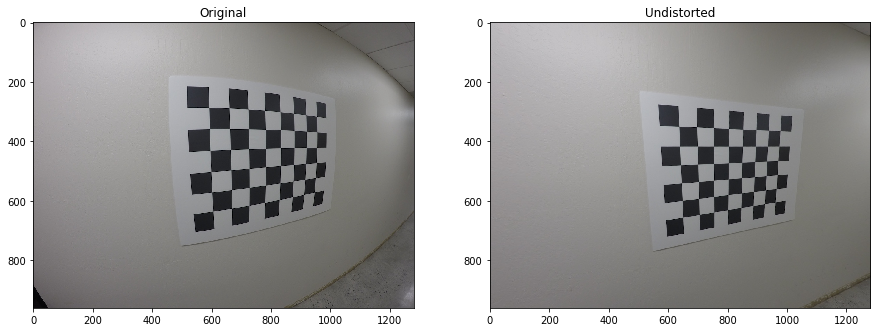

./data/calibration_wide\GOPR0044.jpg


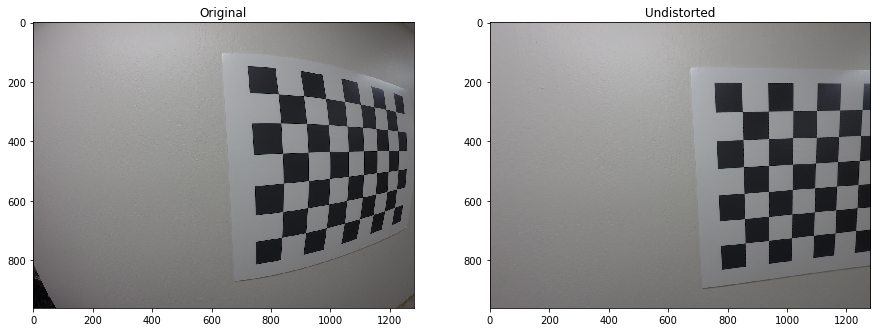

./data/calibration_wide\GOPR0045.jpg


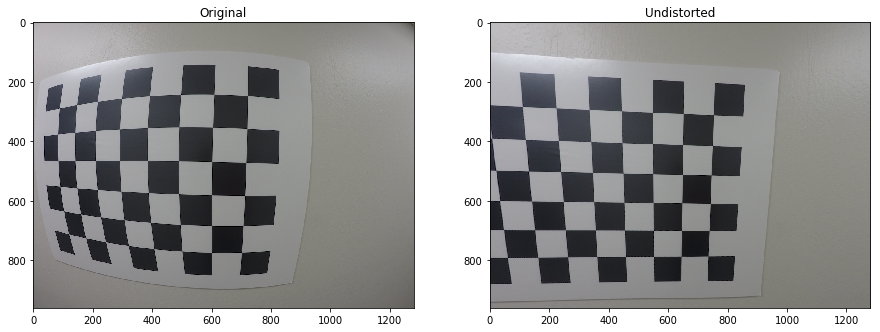

./data/calibration_wide\GOPR0046.jpg


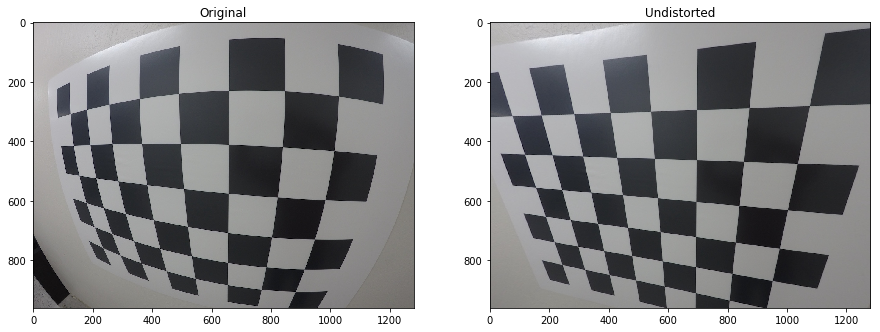

./data/calibration_wide\GOPR0047.jpg


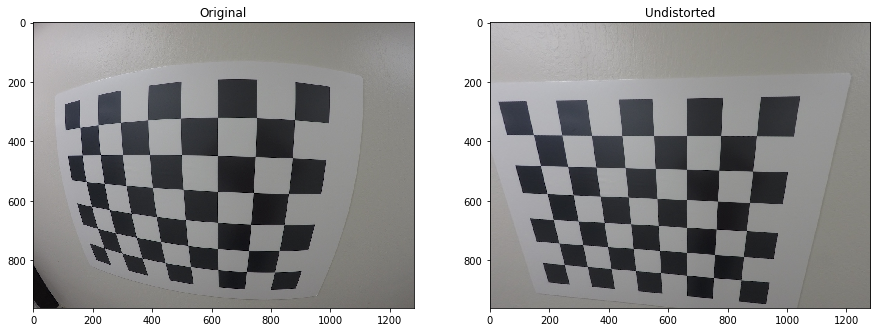

./data/calibration_wide\GOPR0048.jpg


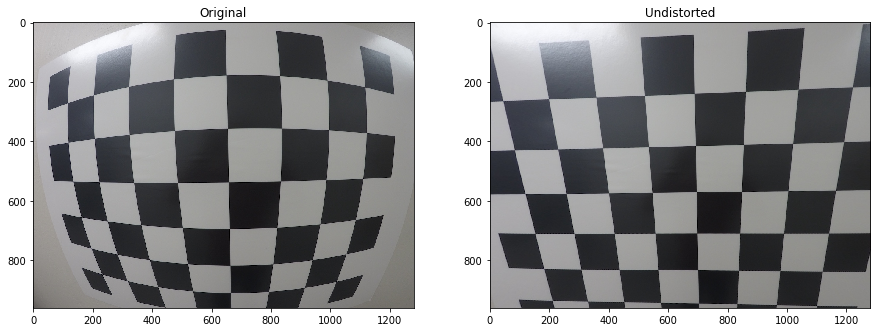

./data/calibration_wide\GOPR0049.jpg


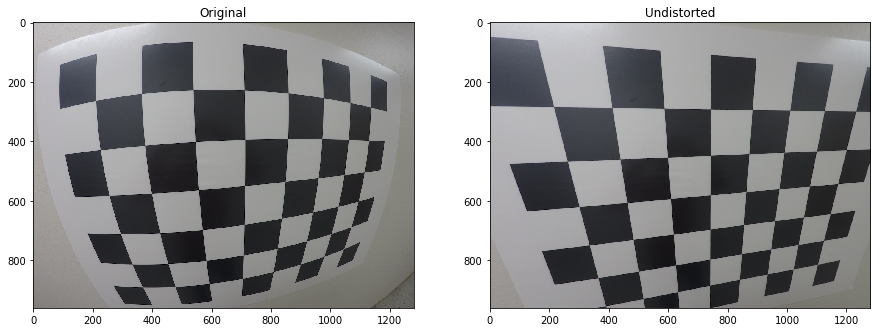

./data/calibration_wide\GOPR0050.jpg


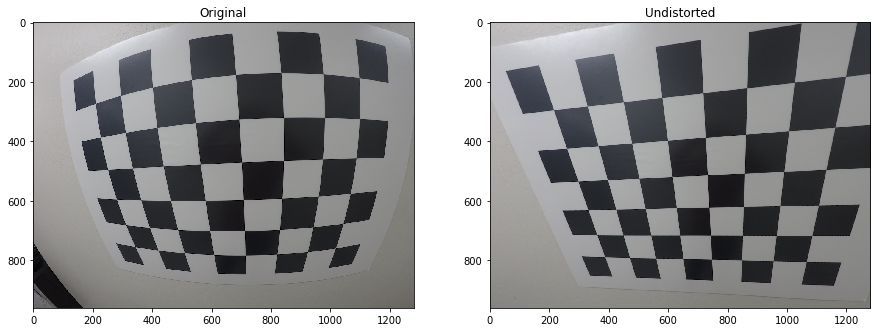

./data/calibration_wide\GOPR0051.jpg


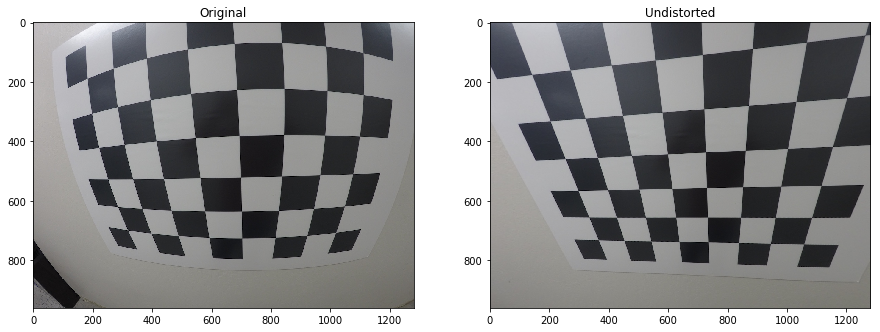

./data/calibration_wide\GOPR0052.jpg


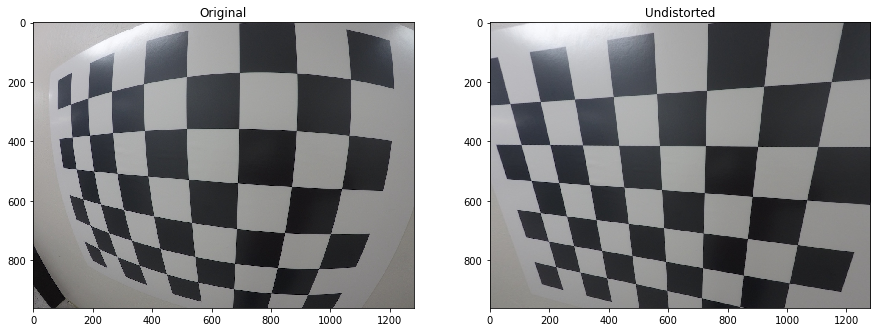

./data/calibration_wide\GOPR0053.jpg


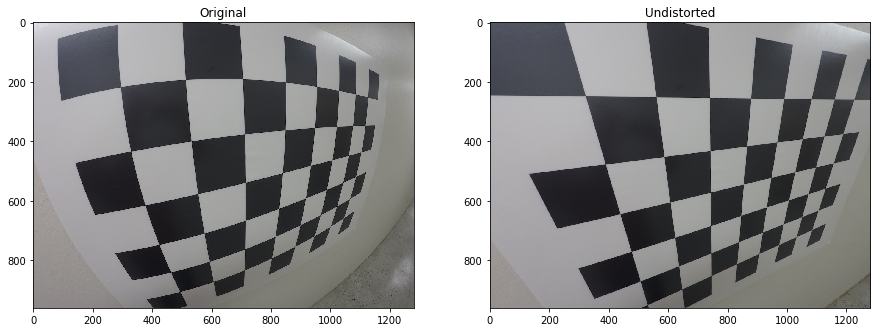

./data/calibration_wide\GOPR0054.jpg


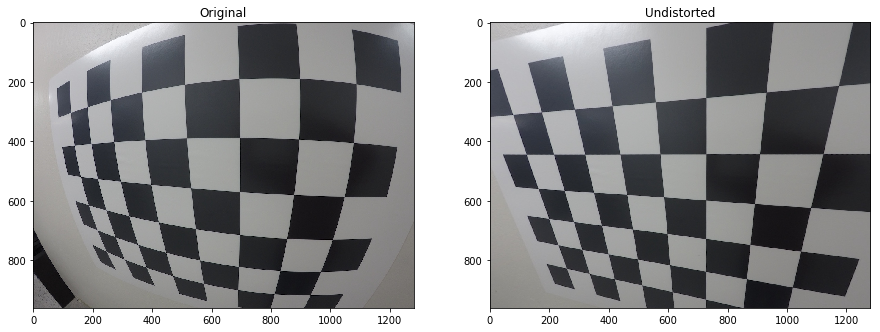

./data/calibration_wide\GOPR0055.jpg


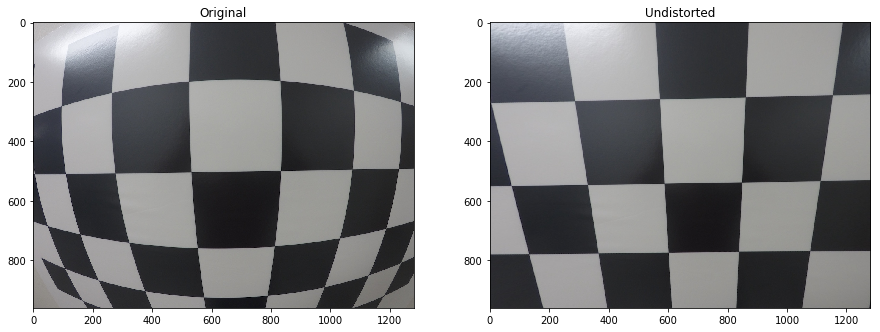

./data/calibration_wide\GOPR0057.jpg


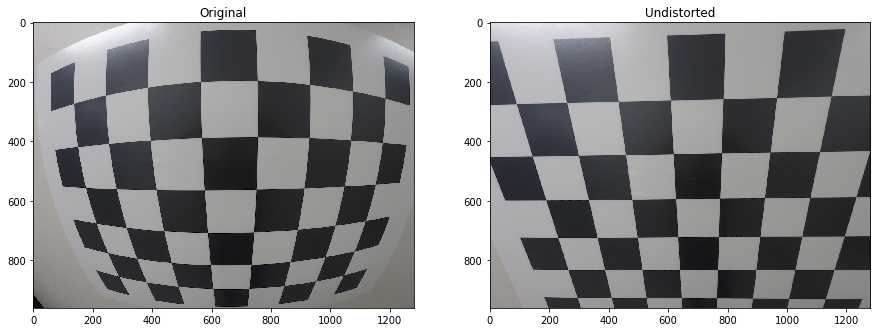

./data/calibration_wide\GOPR0058.jpg


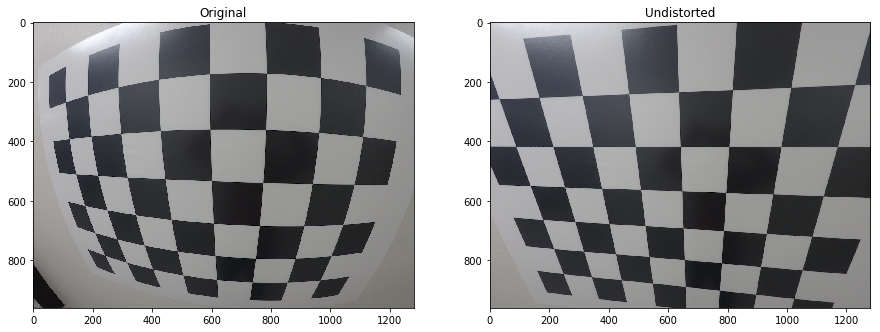

./data/calibration_wide\GOPR0059.jpg


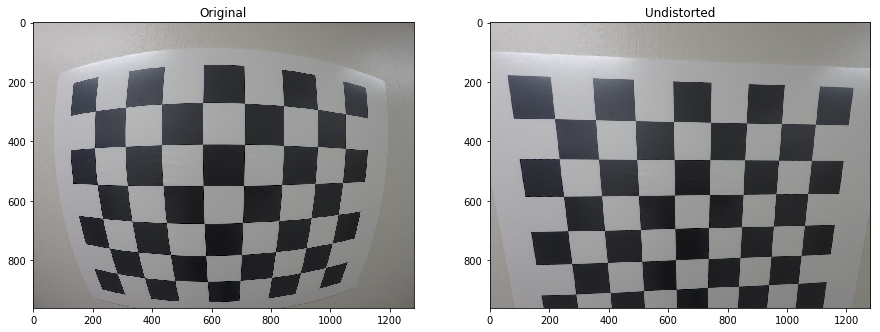

./data/calibration_wide\GOPR0060.jpg


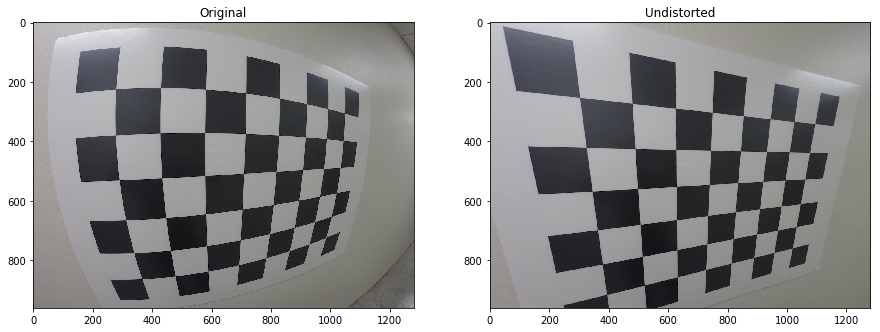

./data/calibration_wide\GOPR0061.jpg


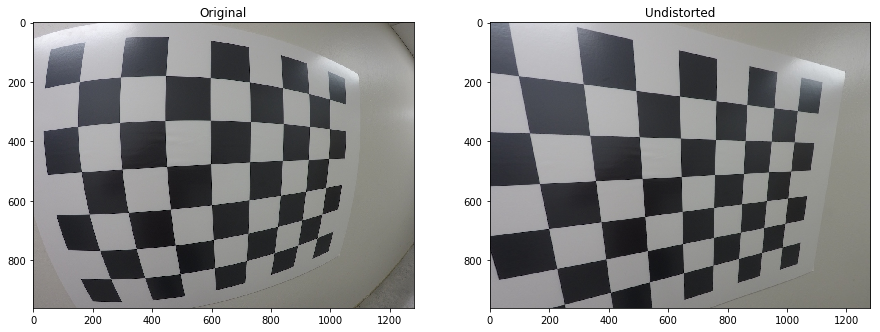

./data/calibration_wide\GOPR0062.jpg


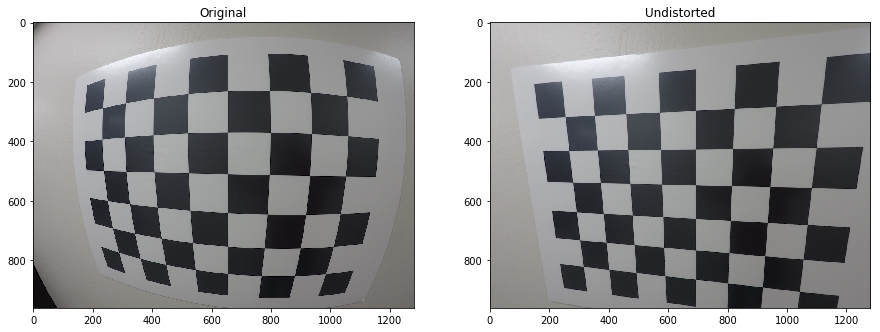

./data/calibration_wide\GOPR0063.jpg


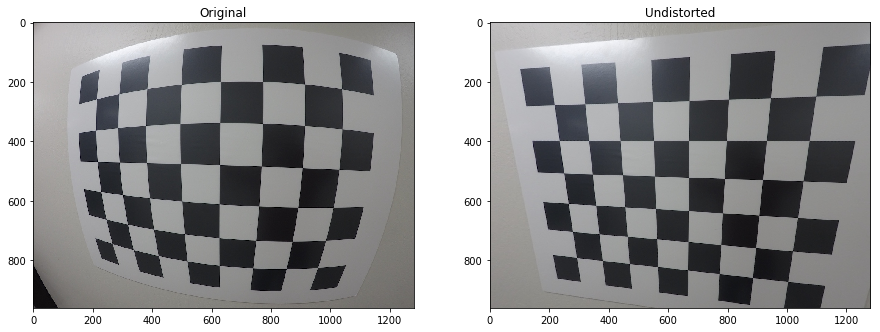

./data/calibration_wide\GOPR0064.jpg


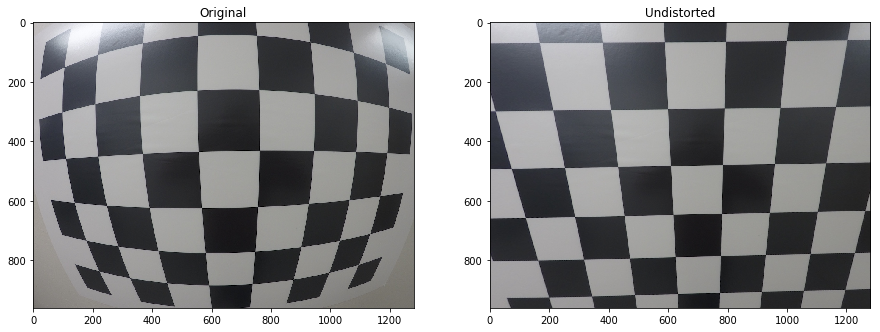

./data/calibration_wide\GOPR0066.jpg


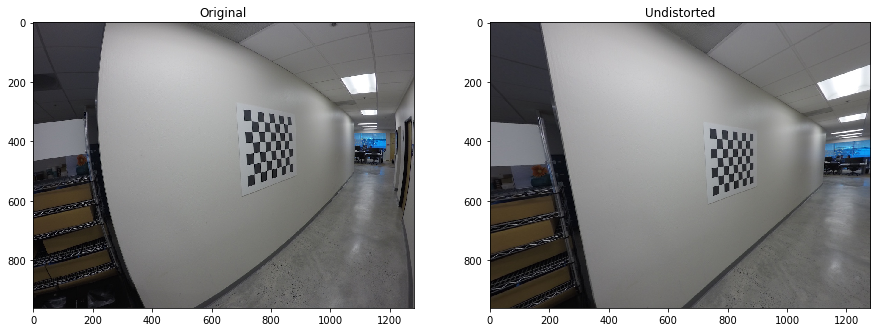

./data/calibration_wide\GOPR0067.jpg


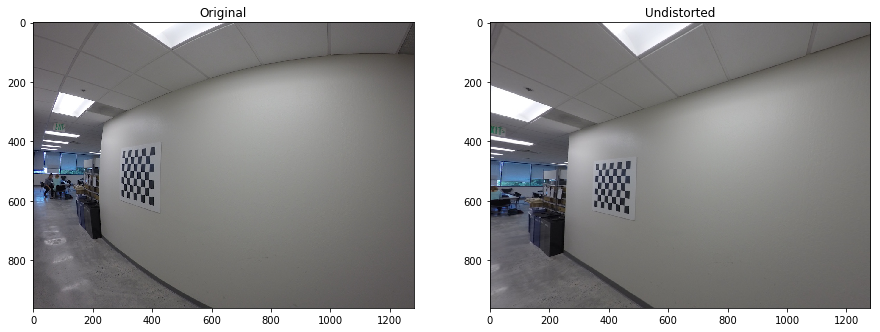

./data/calibration_wide\GOPR0068.jpg


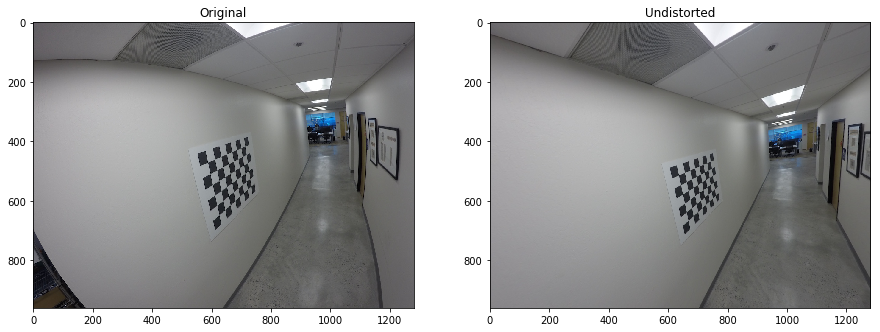

./data/calibration_wide\GOPR0069.jpg


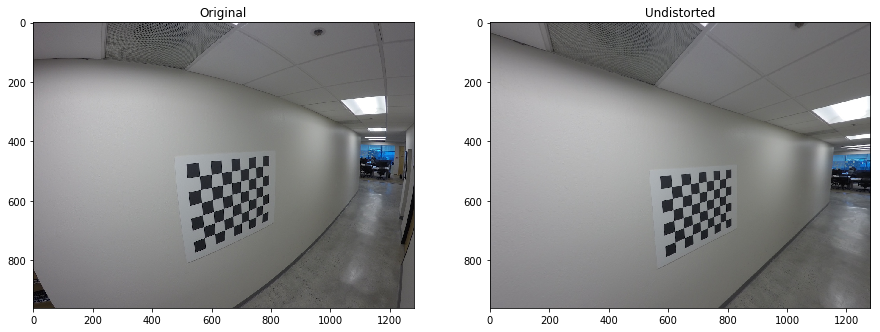

./data/calibration_wide\GOPR0070.jpg


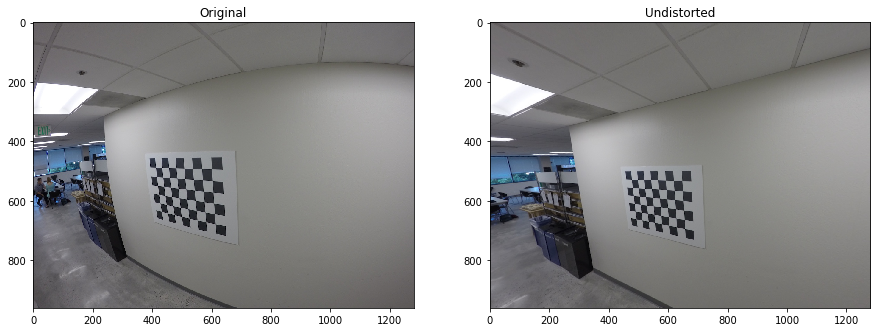

In [49]:
for img in images:
    undistort(img)

./data/calibration_wide\GOPR0032.jpg


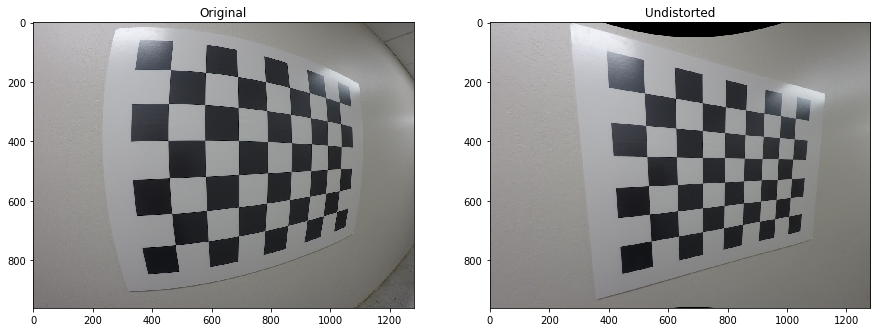

./data/calibration_wide\GOPR0033.jpg


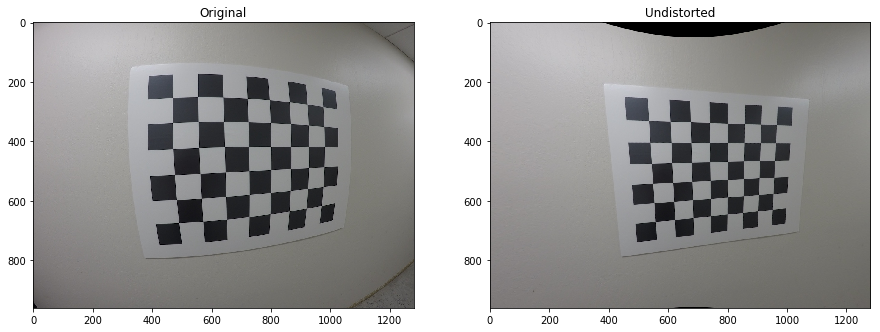

./data/calibration_wide\GOPR0034.jpg


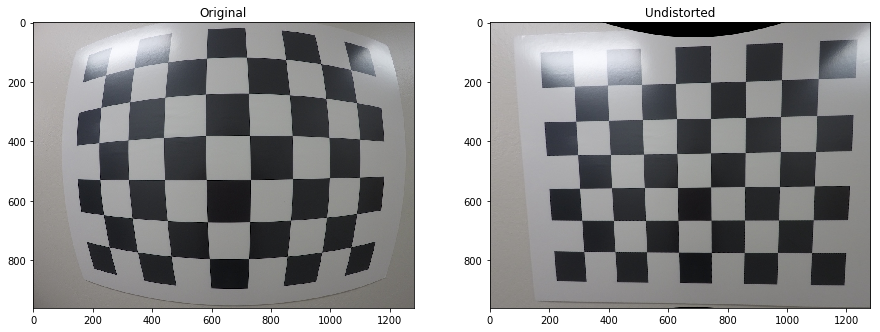

./data/calibration_wide\GOPR0035.jpg


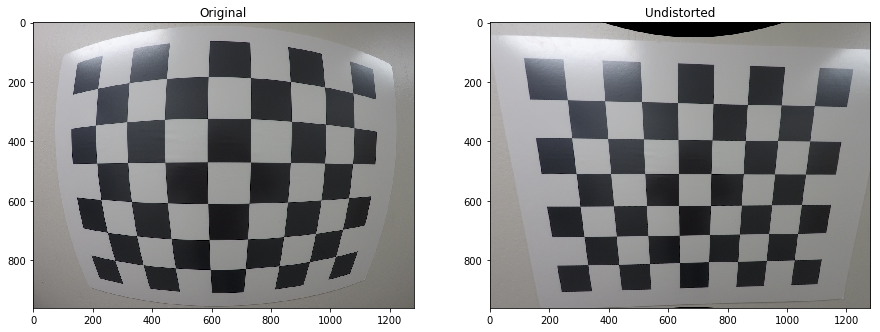

./data/calibration_wide\GOPR0036.jpg


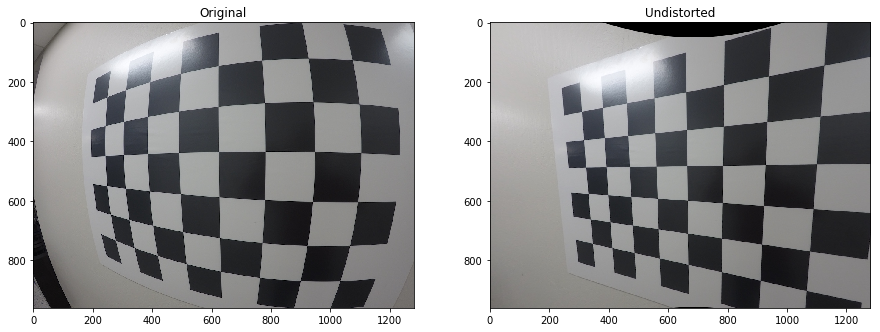

./data/calibration_wide\GOPR0037.jpg


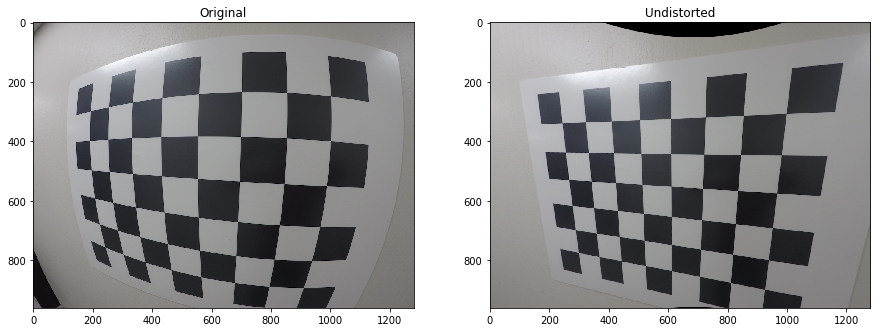

./data/calibration_wide\GOPR0038.jpg


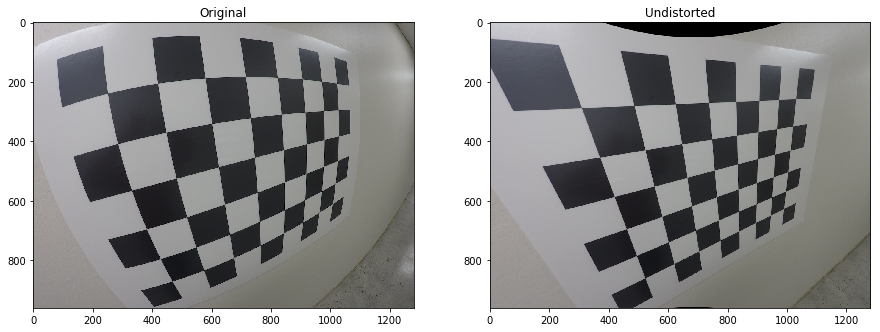

./data/calibration_wide\GOPR0040.jpg


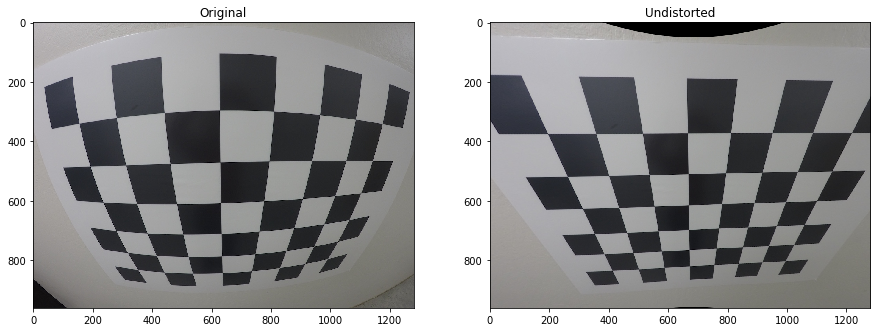

./data/calibration_wide\GOPR0041.jpg


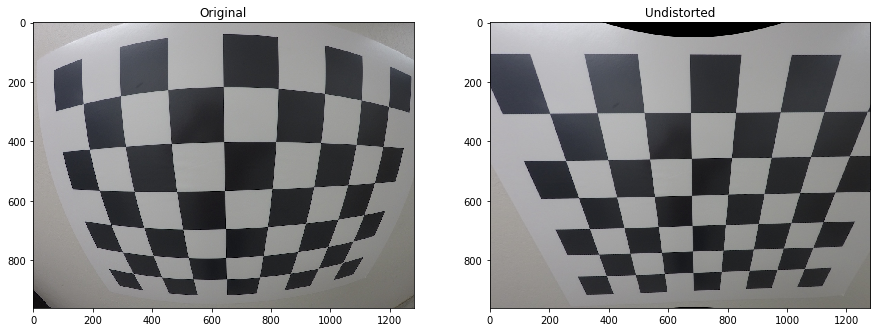

./data/calibration_wide\GOPR0042.jpg


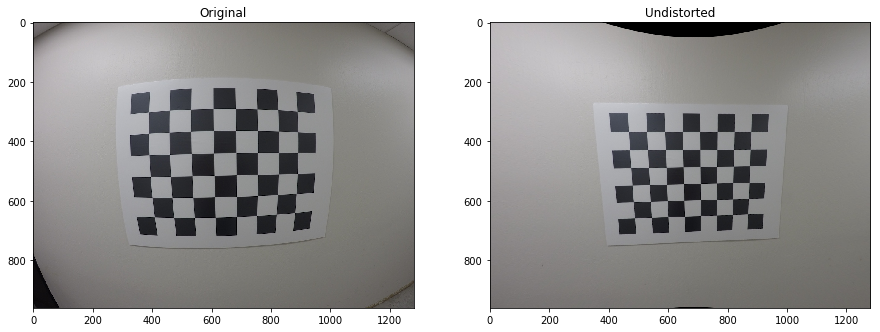

./data/calibration_wide\GOPR0043.jpg


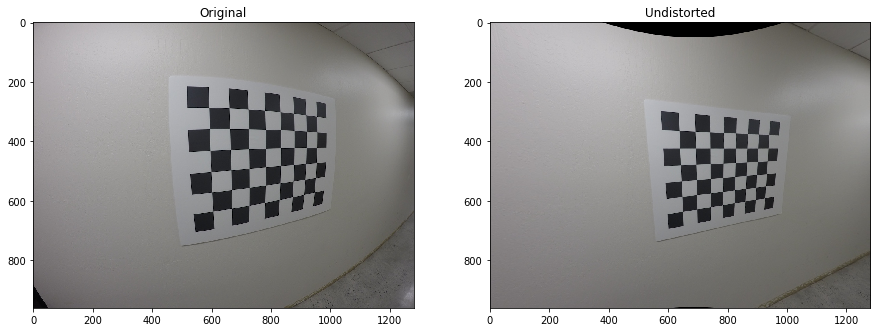

./data/calibration_wide\GOPR0044.jpg


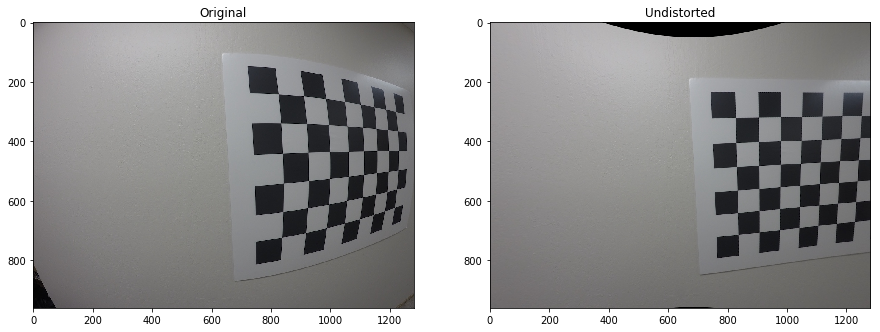

./data/calibration_wide\GOPR0045.jpg


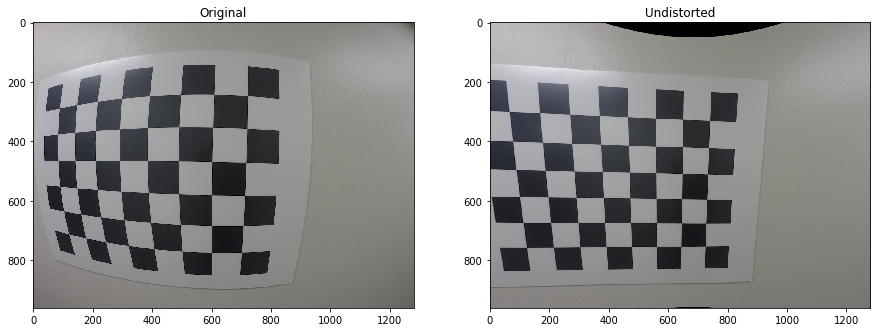

./data/calibration_wide\GOPR0046.jpg


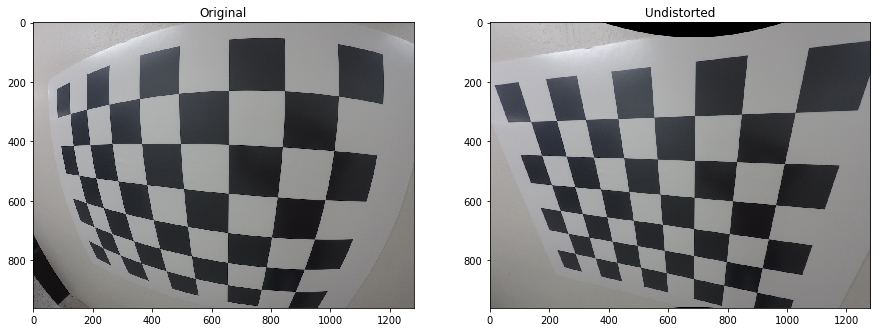

./data/calibration_wide\GOPR0047.jpg


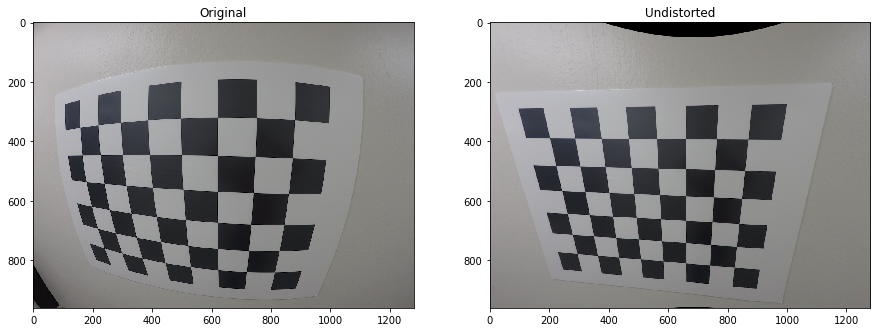

./data/calibration_wide\GOPR0048.jpg


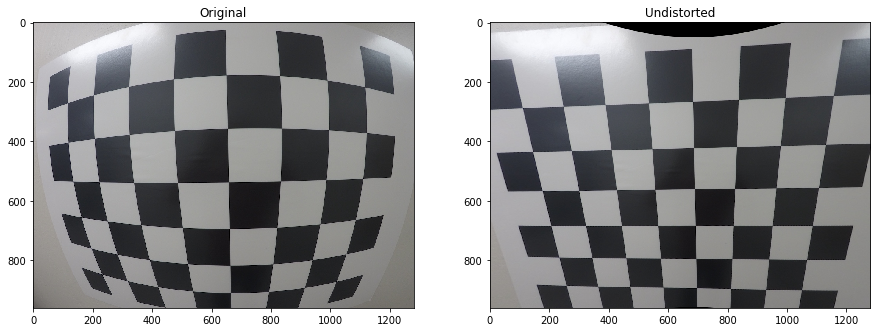

./data/calibration_wide\GOPR0049.jpg


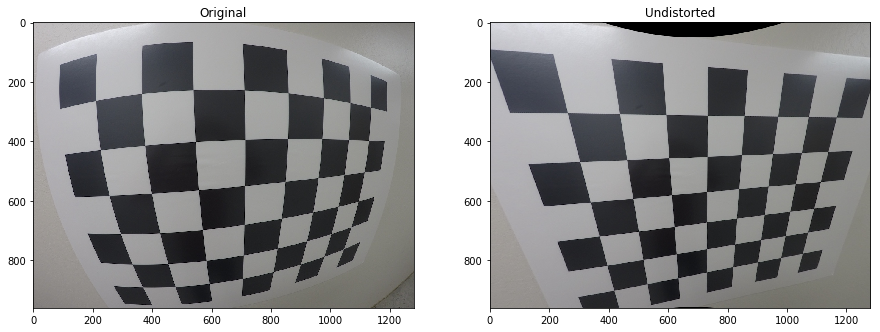

./data/calibration_wide\GOPR0050.jpg


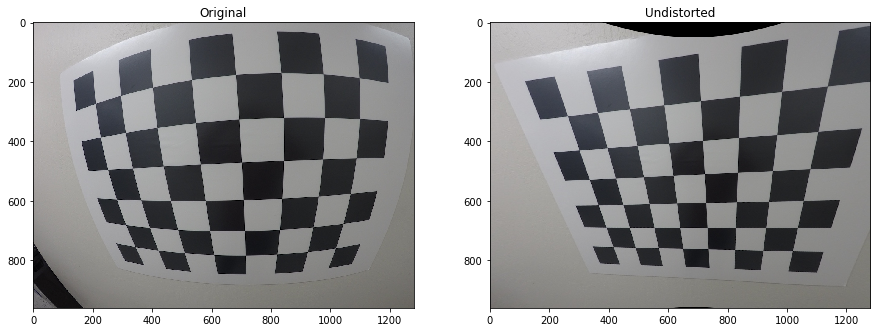

./data/calibration_wide\GOPR0051.jpg


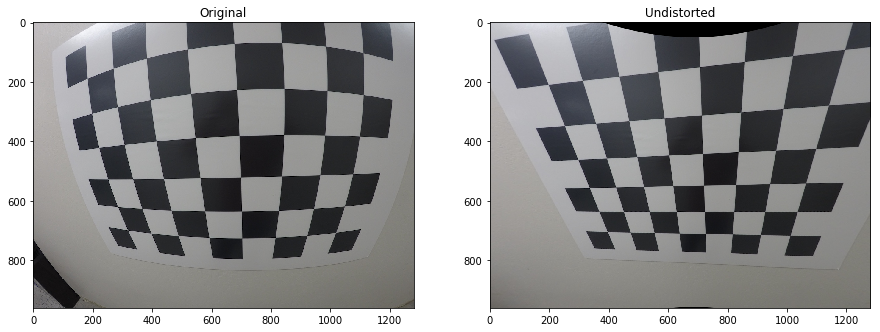

./data/calibration_wide\GOPR0052.jpg


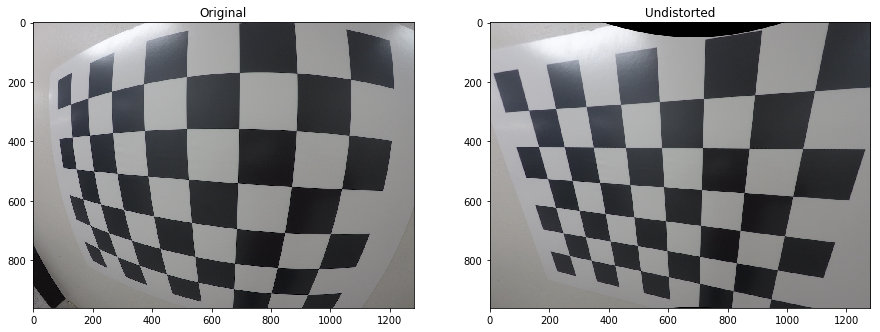

./data/calibration_wide\GOPR0053.jpg


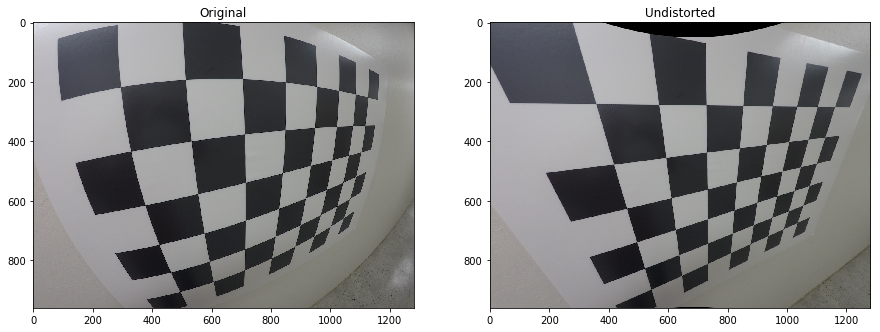

./data/calibration_wide\GOPR0054.jpg


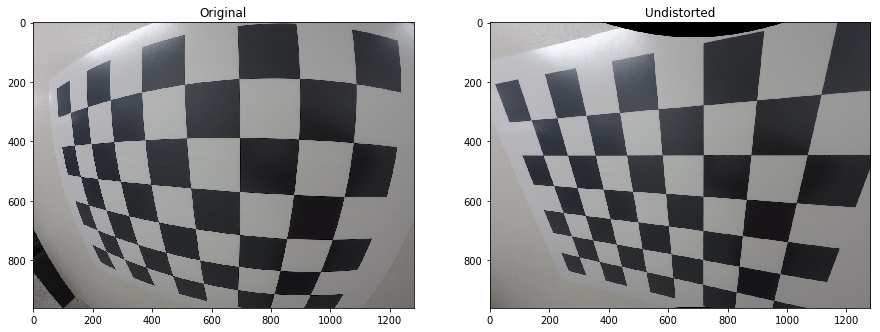

./data/calibration_wide\GOPR0055.jpg


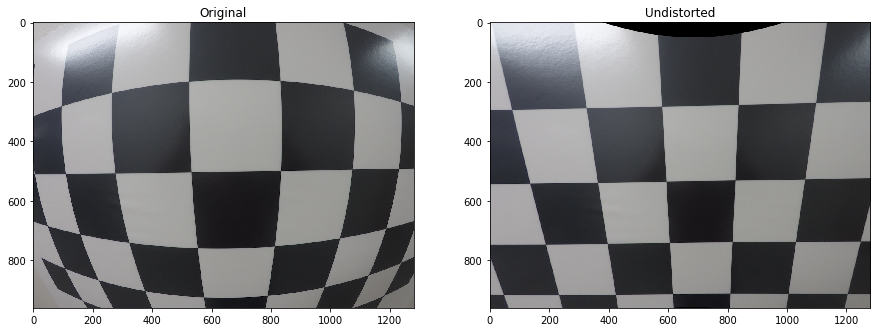

./data/calibration_wide\GOPR0057.jpg


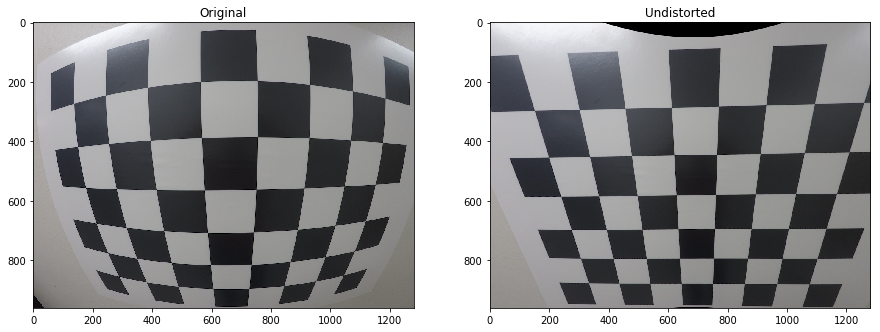

./data/calibration_wide\GOPR0058.jpg


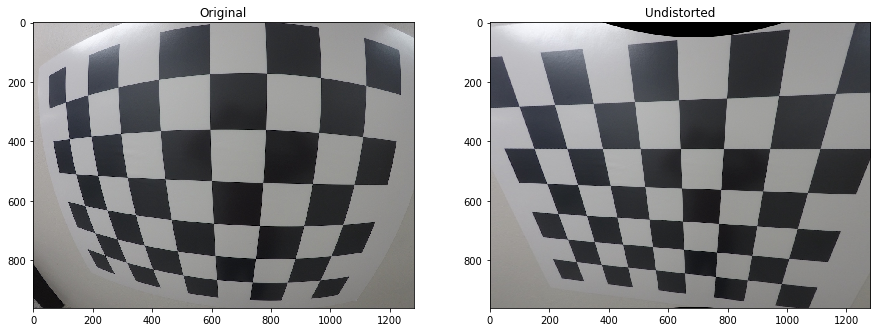

./data/calibration_wide\GOPR0059.jpg


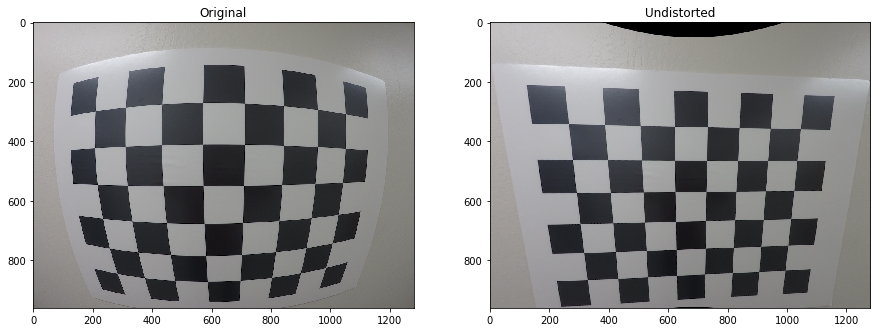

./data/calibration_wide\GOPR0060.jpg


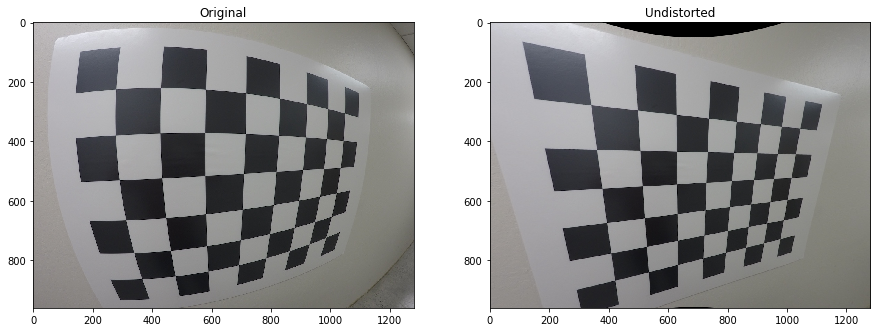

./data/calibration_wide\GOPR0061.jpg


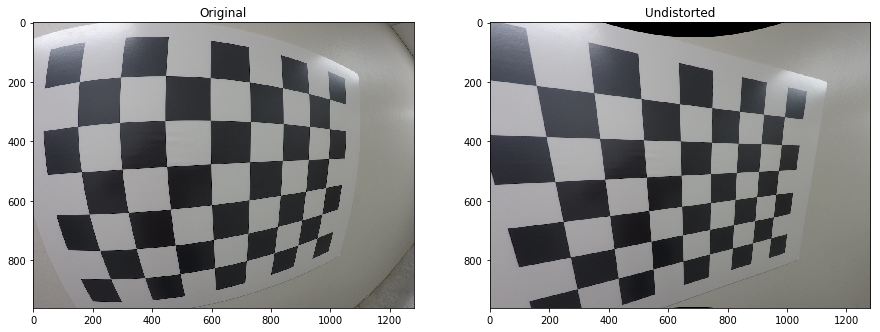

./data/calibration_wide\GOPR0062.jpg


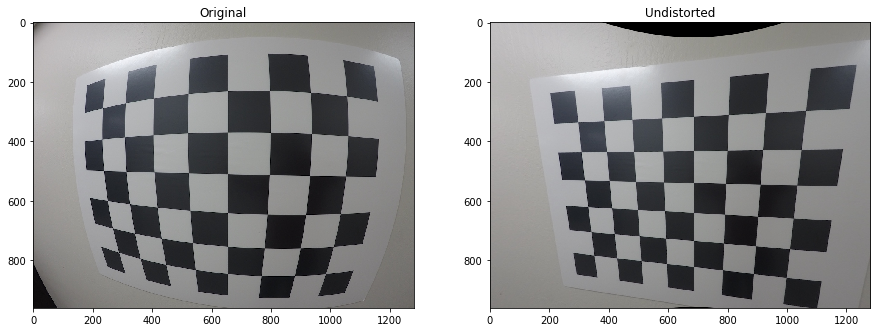

./data/calibration_wide\GOPR0063.jpg


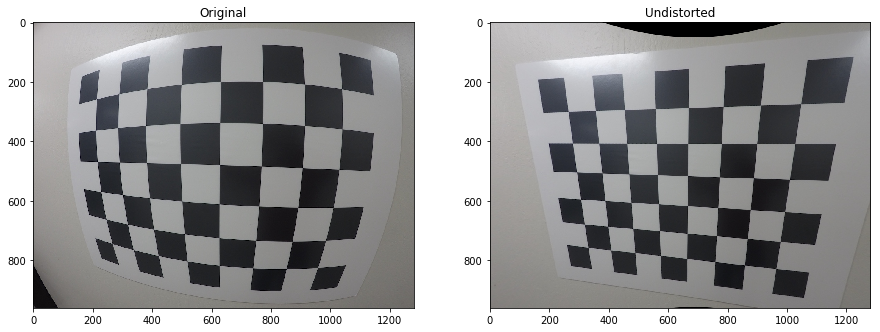

./data/calibration_wide\GOPR0064.jpg


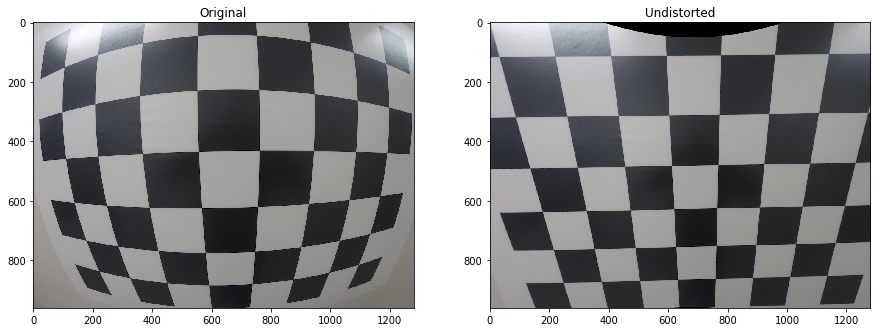

./data/calibration_wide\GOPR0066.jpg


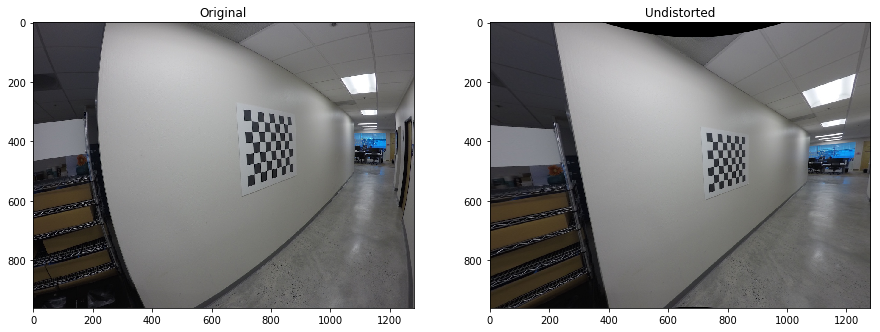

./data/calibration_wide\GOPR0067.jpg


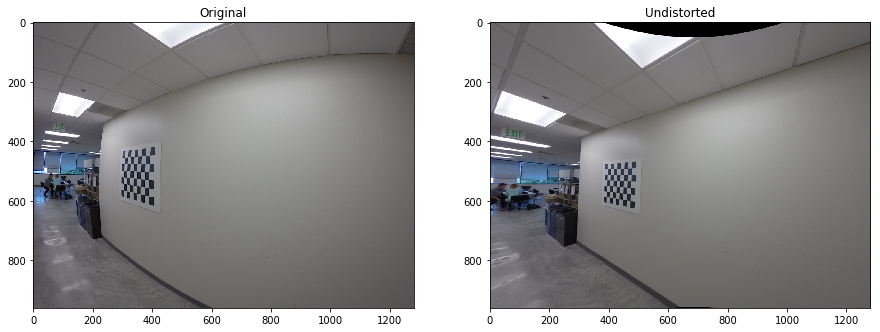

./data/calibration_wide\GOPR0068.jpg


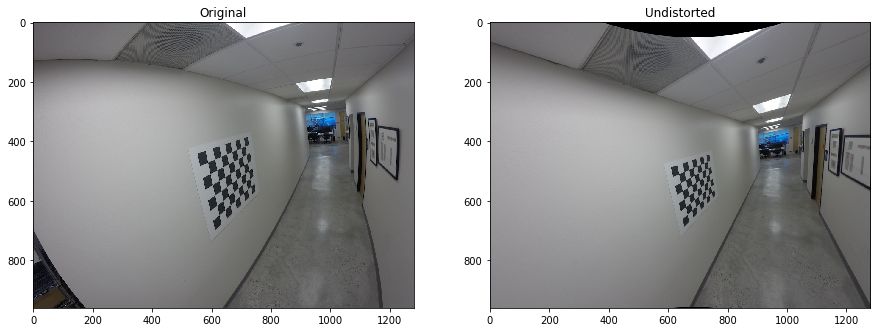

./data/calibration_wide\GOPR0069.jpg


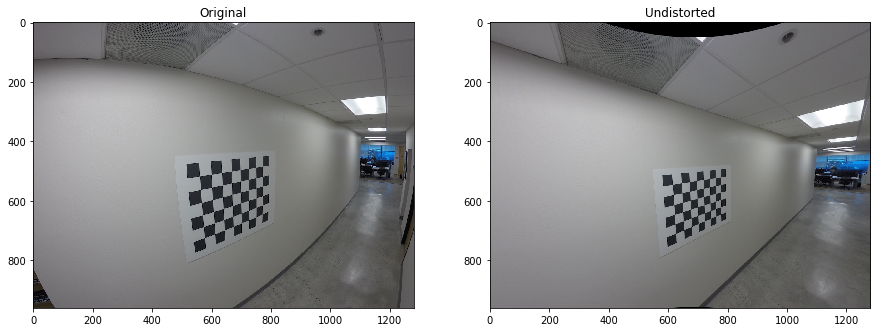

./data/calibration_wide\GOPR0070.jpg


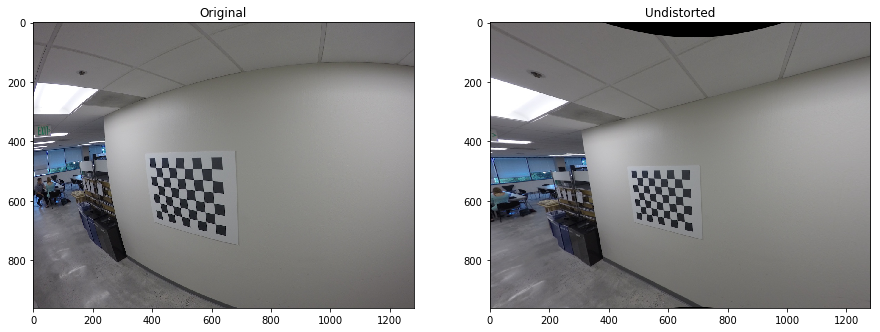

In [53]:
for img in images:
    undistort(img, balance= 0.2)